<a href="https://colab.research.google.com/github/elephantscale/E2E-Object-Detection-in-TFLite/blob/master/colab_training/Tutorial_Object_Detection_with_TFLite.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tutorial: Object Detection with TFLite

## Introduction

Imagine that you have a niece or a nephew and you want to give them a present.
When you were growing up, your aunt gave you a "Find the Duck" book. You had lots of fun
finding the duck on every page of this board book. Today, you want to make this book
into a computer game. For that, you need to be able to teach the computer how to find
the duck. This is what this tutorial will teach you.

<img src="find-the-duck-cartoon.png"  alt="Find the duckie" width="512" height="512">

## Our plan

The task that you are about to undertake is called "Object Detection." The good news is that the
Google library called TensorFlow already does most of the groundwork for object detection.
Furthermore, the TensorFlow Lite part of the library will help you to put your application on a
phone or a device app. The end result of your object detection will look like a screenshot below,
where you will be able to detect, out of a known set of objects, which ones are present
in our picture and what are their locations.

<img src="object-detection-cartoon.png"  alt="Find the salad" width="512" height="512">

We will do it in three steps. First, you will have to prepare the data: those objects that you will be looking to identify.
After you got the objects, you will have to convert them to TFrecord format that Object Detection API expects.
Then, you will train the model with this data. And finally, you will export the model
to TFLite, preparing it to be used in your phone app. In the next tutorial,
we will teach you how to use the resulting TFLite model in your phone app. So, let us start.

In [1]:
# Feel free to add anything more here that might generate random numbers\
import tensorflow as tf
import random
import numpy as np
random.seed(0)
np.random.seed(0)
tf.random.set_seed(0)

## Data collection

We have taken a dataset with pictures of salad. Each data sample has an images
of a salad and an XML file with the salad coordinates.
This dataset came from Kaggle [here](https://www.kaggle.com/mbkinaci/salad-images-for-object-detection), with a Creative Commons license,
so for ease of use we have placed it in next to this tutorial.

In Jupyter Notebook, you can do command lines if you only start with a exclamation sign.
Let us download this dataset first.

In [2]:
!mkdir train_data
!gsutil -q  cp  gs://cloud-ml-data/img/openimage/csv/salads_ml_use.csv ./train_data/ && echo "CSV Downloaded."
!gsutil  -q -m cp  -r gs://cloud-ml-data/img/openimage/* ./train_data/ && echo "Images copied."
!mkdir -p /content/train_zip/train
!mkdir -p /content/test_zip/test
!cp -r /content/train_data/* /content/train_zip/train
!cp -r /content/train_data/* /content/test_zip/test


CSV Downloaded.
Images copied.


In the same way, let us unzip the dataset

In [3]:
import re
import pandas as pd

data = pd.read_csv('./train_data/csv/salads_ml_use.csv', header=None, names=['dataset', 'filename', 'class', 'xmin', 'ymin', 'e1', 'e2', 'xmax', 'ymax', 'e3', 'e4'])

data.filename = data.filename.apply(lambda x : re.sub(r'gs:\/\/cloud\-ml\-data\/img\/openimage\/', r'', x))
data.pop('e1')
data.pop('e2')
data.pop('e3')
data.pop('e4')

data.head()

,dataset,filename,class,xmin,ymin,xmax,ymax
0,TEST,103/279324025_3e74a32a84_o.jpg,Baked Goods,0.005743,0.084985,0.567511,0.735736
1,TEST,103/279324025_3e74a32a84_o.jpg,Salad,0.402759,0.310473,1.000000,0.982695
2,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.000000,0.000000,0.054865,0.480665
3,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.041131,0.401678,0.318230,0.785916
4,TEST,1064/3167707458_7b2eebed9e_o.jpg,Cheese,0.116263,0.065161,0.451528,0.286489


In [4]:
from PIL import Image
import os

def get_width_height(s):

    root = "/content/train_zip/train"
    s['width'], s['height'] = Image.open(os.path.join(root, s["filename"])).size
    s['xmin'] = int(s['xmin'] * s['width'])
    s['ymin'] = int(s['ymin'] * s['height'])
    s['xmax'] = int(s['xmax'] * s['width'])
    s['ymax'] = int(s['ymax'] * s['height'])
    return(s)


data = data.apply(get_width_height, axis=1)
data = data[['dataset', 'filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']]
data.head()

,dataset,filename,width,height,class,xmin,ymin,xmax,ymax
0,TEST,103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
1,TEST,103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
2,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
3,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703
4,TEST,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,256,141,996,620


In [5]:
train_df = data[data['dataset'] == "TRAIN"]
train_df.pop("dataset")
test_df = data[data['dataset'] == "TEST"]
test_df.pop("dataset")

train_df.to_csv("train_data/train.csv", index=False, header=True)
test_df.to_csv("train_data/test.csv", index=False, header=True)

train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
410,3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
411,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
412,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
413,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
414,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353


In [6]:
!cp /content/train_data/train.csv /content/train_zip/train_labels.csv
!cp /content/train_data/train.csv /content/test_zip/test_labels.csv


## Generate intermediate files

To be able to generate TFRecords from our salads dataset we first generate a `.csv` file that would contain the following fields - 
- filename
- width
- height
- class
- xmin
- ymin
- xmax
- ymax

Now, we need to convert the XML descriptions to CSV. In your case,
you may have to adjust this code, depending on the format of the data
in your real-life dataset.

In [7]:
!head -5 /content/train_data/train.csv

filename,width,height,class,xmin,ymin,xmax,ymax
3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485


In [8]:
!head -5 /content/train_data/test.csv
#filename,width,height,class,xmin,ymin,xmax,ymax


filename,width,height,class,xmin,ymin,xmax,ymax
103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703


Now that we have `.csv` files we can do some basic exploratory data analysis (EDA) to better understand the dataset.

## Basic EDA

In [9]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import cv2
import os

In [10]:
train_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
410,3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
411,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
412,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
413,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
414,3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353


In [11]:
test_df.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,103/279324025_3e74a32a84_o.jpg,1600,1200,Baked Goods,9,101,908,882
1,103/279324025_3e74a32a84_o.jpg,1600,1200,Salad,644,372,1600,1179
2,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,0,0,121,1041
3,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,90,870,702,1703
4,1064/3167707458_7b2eebed9e_o.jpg,2207,2167,Cheese,256,141,996,620


In [12]:
train_df["class"].value_counts()

Tomato         606
Cheese         377
Salad          184
Seafood        114
Baked Goods     66
Name: class, dtype: int64

In [13]:
test_df["class"].value_counts()

Tomato         96
Cheese         51
Salad          33
Seafood        22
Baked Goods    16
Name: class, dtype: int64

In [14]:
def show_images(df, is_train=True):
    if is_train:
        root = "/content/train_zip/train"
    else:
        root = "/content/test_zip/test"
    plt.figure(figsize=(15,15))
    for i in range(10):
        n = np.random.choice(df.shape[0], 1)
        plt.subplot(5,5,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(True)
        #image = plt.imread(os.path.join(root, df["filename"][int(n)]))
        #print(df["filename"][int(n)])
        #image = plt.imread(df["filename"][int(n)])
        image = plt.imread(os.path.join(root, df.iloc[int(n),:]["filename"]))
        plt.imshow(image)
        label = df.iloc[int(n),:]["class"]
        plt.xlabel(label)
    plt.show()

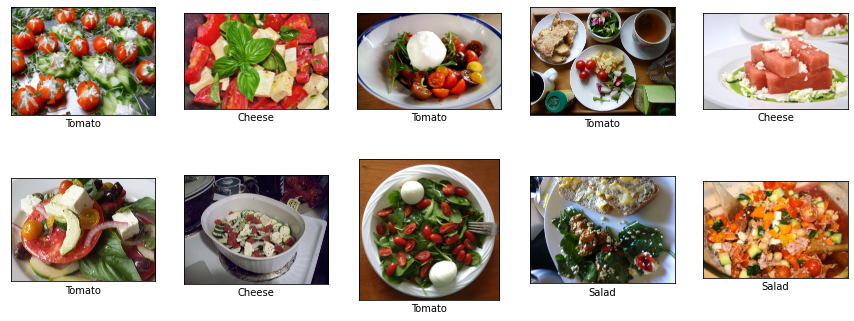

In [15]:
show_images(train_df)

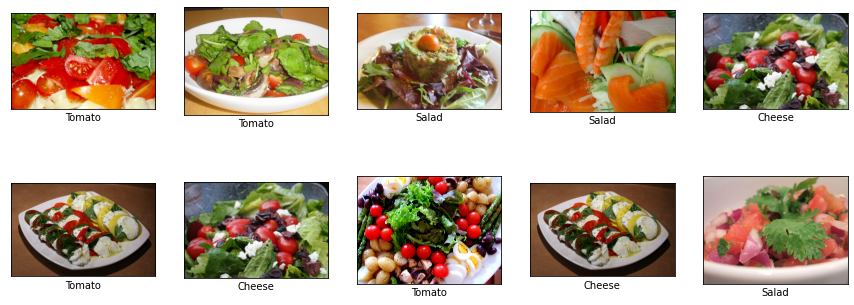

In [16]:
show_images(test_df, is_train=False)

In [17]:
def verify_annotations(df, is_train=True):
    if is_train:
        root = "/content/train_zip/train"
    else:
        root = "/content/test_zip/test"
    
    plt.figure(figsize=(12,12))
    for i in range(3):
        n = np.random.choice(df.shape[0], 1)
        plt.subplot(1,3,i+1)
        plt.xticks([])
        plt.yticks([])
        
        #image = plt.imread(os.path.join(root, df["filename"][int(n)]))
        image = plt.imread(os.path.join(root, df.iloc[int(n),:]["filename"]))

        xmin, ymin = int(df.iloc[int(n),:]["xmin"]), int(df.iloc[int(n),:]["ymin"])
        xmax, ymax = int(df.iloc[int(n),:]["xmax"]), int(df.iloc[int(n),:]["ymax"])
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (255,0,0), 3)
        plt.imshow(image)
    
    plt.show()

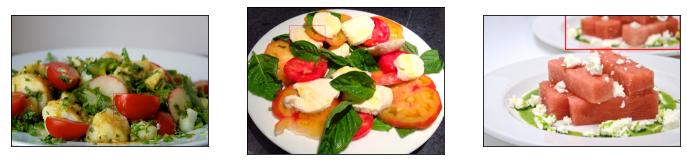

In [18]:
verify_annotations(train_df, is_train=True)

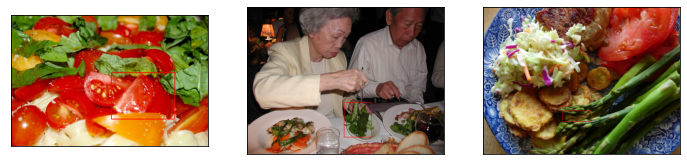

In [19]:
verify_annotations(test_df, is_train=False)

As we can see the dataset has annotation issues. So, our model training can suffer a lot from this. So, one can expect a model trained on this dataset might yield unexpected results. 

## Generate TFRecords and `.pbtxt`

The TFRecord format is a simple format for storing a sequence of binary records.
The format is explained [here](https://www.tensorflow.org/tutorials/load_data/tfrecord)
but for our purposes it is enough that the code below created these records for us.

The utility scripts that I used in the following cells were adapted from [this repository](https://github.com/anirbankonar123/CorrosionDetector). 



In [20]:
%tensorflow_version 2.x
import tensorflow as tf 
print(tf.__version__)

!git clone https://github.com/tensorflow/models.git

% cd models/research
!pip install --upgrade pip
# Compile protos.
!protoc object_detection/protos/*.proto --python_out=.
# Install TensorFlow Object Detection API.
!cp object_detection/packages/tf1/setup.py .
!python -m pip install --use-feature=2020-resolver .

2.4.1
Cloning into 'models'...
remote: Enumerating objects: 10, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 51444 (delta 2), reused 8 (delta 0), pack-reused 51434
Receiving objects: 100% (51444/51444), 568.87 MiB | 37.56 MiB/s, done.
Resolving deltas: 100% (35114/35114), done.
/content/models/research
     |████████████████████████████████| 1.5MB 6.9MB/s 
  Found existing installation: pip 19.3.1
    Uninstalling pip-19.3.1:
      Successfully uninstalled pip-19.3.1
Processing /content/models/research
     |████████████████████████████████| 352 kB 7.8 MB/s 
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1618434 sha256=c7287540ea29bfdc323c17a2e74c0fc122e50ee40816108432554d10634ad542
  Stored in directory: /tmp/pip-ephem-wheel-cache-pjwzudvw/wheels/16/63/fd/1293066bf448f757979af1b45c59b0e33b46f12d4454d12fde
Successfully built object-detection


In [21]:
#!wget https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/master/colab_training/generate_tfrecord.py
!wget https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_tfrecord.py
!wget https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_tfrecord_tf2.py

--2021-02-08 00:52:02--  https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_tfrecord.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3740 (3.7K) [text/plain]
Saving to: ‘generate_tfrecord.py’

generate_tfrecord.p 100%[===================>]   3.65K  --.-KB/s    in 0s      

2021-02-08 00:52:02 (77.4 MB/s) - ‘generate_tfrecord.py’ saved [3740/3740]

--2021-02-08 00:52:02--  https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/generate_tfrecord_tf2.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connect

In [22]:
!python generate_tfrecord_tf2.py \
    --csv_input=/content/train_zip/train_labels.csv \
    --output_path=/content/train_zip/train.record

2021-02-08 00:52:03.235232: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/train_zip/train.record


Before the running the cell below please edit the `path` variable in the `main()` function of `generate_tfrecord.py`. `generate_tfrecord.py` should be located here - `/content/models/research`. 

In [23]:
!head /content/test_zip/test_labels.csv 

filename,width,height,class,xmin,ymin,xmax,ymax
3/2851/9211707942_609c7209f8_o.jpg,612,612,Salad,0,0,612,612
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,3,146,104,252
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,18,484,463,611
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,58,349,317,485
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,109,172,266,353
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,199,24,319,151
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,214,189,356,320
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,257,273,453,398
3/2851/9211707942_609c7209f8_o.jpg,612,612,Tomato,349,140,452,288


In [24]:
!python generate_tfrecord_tf2.py \
    --csv_input=/content/test_zip/test_labels.csv \
    --output_path=/content/test_zip/test.record

2021-02-08 00:52:06.613240: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
Successfully created the TFRecords: /content/test_zip/test.record


In [25]:
!pwd
!ls -lh /content/test_zip/*.record
!ls -lh /content/train_zip/*.record

/content/models/research
-rw-r--r-- 1 root root 257M Feb  8 00:52 /content/test_zip/test.record
-rw-r--r-- 1 root root 257M Feb  8 00:52 /content/train_zip/train.record


Be sure to store these `.record` files to somewhere safe. Next, we need to generate a `.pbtxt` file that defines a mapping between our classes and integers. In the `generate_tfrecord.py` script, we used the following mapping - 

```python
def class_text_to_int(row_label):
    if row_label == 'orange':
        return 1
    elif row_label == 'banana':
        return 2
    elif row_label == 'apple':
        return 3
    else:
    	return None
```

In [30]:
label_encodings = {
    'Baked Goods' : 1,
    'Cheese' : 2,
    'Salad' : 3,
    'Seafood' : 4,
    'Tomato' : 5
}


f = open("/content/models/research/label_map.pbtxt", "w")

for (k, v) in label_encodings.items():
    item = ("item {\n"
            "\tid: " + str(v) + "\n"
            "\tname: '" + k + "'\n"
            "}\n")
    f.write(item)

f.close()

!cat /content/models/research/label_map.pbtxt

item {
	id: 1
	name: 'Baked Goods'
}
item {
	id: 2
	name: 'Cheese'
}
item {
	id: 3
	name: 'Salad'
}
item {
	id: 4
	name: 'Seafood'
}
item {
	id: 5
	name: 'Tomato'
}


Be sure to save this file as well. Next we will proceed toward training a custom detection model with what we have so far. Follow the steps in [this notebook](https://colab.research.google.com/github/sayakpaul/E2E-Object-Detection-in-TFLite/blob/master/colab_training/Training_MobileDet_Custom_Dataset.ipynb).

In this notebook we will be fine-tuning a **MobileNet** model on the [**salads dataset**](https://www.kaggle.com/mbkinaci/salad-images-for-object-detection).  The purpose is to demonstrate the workflow here and not achieve state-of-the-art results. So, please expect unexpected performance for a shorter training schedule. Toward the very end, we will also see how to optimize our fine-tuned model using TensorFlow Lite APIs and run inference with it. 
As a prerequisite, you should be familiar with the contents of [this notebook](https://colab.research.google.com/github/sayakpaul/E2E-Object-Detection-in-TFLite/blob/master/colab_training/Salads_Detection_Data_Prep.ipynb). It deals with the dataset contstruction part. 

# Fetch pre-trained Mobilenet model checkpoints and configuration

MobileNet comes in different variants (refer [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md)). We will be using the `ssdlite_mobilenet_cpu` variant. 

TFOD API operates with configuration files to train and evaluate models (the TF 2 release supports eager model execution too). For the purpose of this notebook, I created a configuration file following instructions from [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/configuring_jobs.md). Note that I purposefully kept the `num_steps` argument to 2000. Here's a *non-exhaustive* list of the arguments I changed - 

-  `batch_size: 32`
- `label_map_path` and `input_path` inside `train_input_reader` and `tf_record_input_reader` respectively. The `num_examples` argument inside `eval_config` is set to 117.

### Download model checkpoint and config

In [31]:
!cd /content/models/research

#!wget -q http://download.tensorflow.org/models/object_detection/ssdlite_mobiledet_cpu_320x320_coco_2020_05_19.tar.gz
!wget -q http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!rm -rf *.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssdlite_mobiledet_cpu_320x320_salads_sync_4x4.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_2.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_3.config
!wget -q https://raw.githubusercontent.com/elephantscale/E2E-Object-Detection-in-TFLite/tim/colab_training/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_4.config


### Untar and verify the file structure of the model checkpoints

In [33]:
!cd /content/models/research
!tar -xvf ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!cp /content/test_zip/test.record /content/models/research
!cp /content/train_zip/train.record /content/models/research

ssd_mobilenet_v2_320x320_coco17_tpu-8/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/variables/variables.index


# Model training

### Start training

**Note**: This script interleaves both training and evaluation. Before starting the training verify the paths carefully.



In [34]:

import os
os.environ['PYTHONPATH'] += ":/content/models"

import sys
sys.path.append("/content/models")


In [35]:
!mv /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0



In [ ]:
#!ls -l ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint
#!rm -rf /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/mobilenet_v2.ckpt-1
#!cp -r ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/mobilenet_v2.ckpt-1

In [36]:
#PIPELINE_CONFIG_PATH="/content/models/research/ssdlite_mobiledet_cpu_320x320_salads_sync_4x4.config"
#PIPELINE_CONFIG_PATH="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2.config"
#PIPELINE_CONFIG_PATH="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_2.config"
#PIPELINE_CONFIG_PATH="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_3.config"
PIPELINE_CONFIG_PATH="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8_tf2_4.config"


#MODEL_DIR="/content/models/research/ssdlite_mobiledet_cpu_320x320_coco_2020_05_19"
MODEL_DIR="/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8"

!echo $PIPELINE_CONFIG_PATH
!echo $MODEL_DIR

!python object_detection/model_main_tf2.py \
    --pipeline_config_path={PIPELINE_CONFIG_PATH} \
    --model_dir={MODEL_DIR} \
    --alsologtostderr

Streaming output truncated to the last 5000 lines.
           2.21086349e-02, -8.72047711e-03, -5.22254519e-02,
          -1.47725008e-02, -1.09574609e-02,  6.91402936e-03,
          -1.51059646e-02,  8.52925424e-03, -1.86960399e-02,
          -4.63603958e-02,  2.88619753e-02,  1.67152267e-02,
          -1.25597771e-02, -1.69952847e-02,  2.48892549e-02,
          -1.75242161e-03, -1.24213034e-02],
         [-2.90123820e-02, -4.87723239e-02, -2.79128551e-02,
           1.16386050e-02,  4.11184318e-02,  1.33859541e-03,
          -2.65208036e-02, -1.74769852e-02,  3.56894545e-02,
          -2.56457869e-02, -2.32697241e-02,  2.65336217e-04,
           3.87472808e-02, -3.22738141e-02, -5.83131686e-02,
          -3.98741919e-04,  3.16076502e-02,  2.59662438e-02,
           6.64395373e-03, -6.34559104e-03, -1.86991841e-02,
           1.18608549e-02,  2.86218319e-02,  5.59415445e-02,
           2.98439097e-02, -1.64085012e-02,  1.14401504e-02,
          -7.38184666e-03, -1.59600955e-02, -1.402

In [37]:
!ls -d /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/*


/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model
/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/train


In [38]:
!zip -r ssd_mobilenet_v2_320x320_coco17_tpu-8.zip ssd_mobilenet_v2_320x320_coco17_tpu-8/

  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/train/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/train/events.out.tfevents.1612745812.27c7f019268f.741.2928.v2 (deflated 10%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config (deflated 67%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0/ (stored 0%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0/ckpt-0.index (deflated 12%)
  adding: ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint0/ckpt-0.data-00000-of-00001


zip error: Interrupted (aborting)


The above code block would take approximately **30 minutes** to run (although it depends on the GPU you got if you are running on Colab). If you increase the number of steps it would be even more. After the training was completed I got the following output - 

```
I0915 04:48:33.129830 139851326252928 estimator.py:371] Loss for final step: 1.0553685.
```

# Export TFLite compatible graph

To export the fine-tuned checkpoints to a TFLite model we first need to export a model graph that is compatible with TFLite. More instructions about this are available [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/running_on_mobile_tensorflowlite.md). First, we need to determine which checkpoints to be used to export the graph. Let's first take a look at our `MODEL_DIR` to get an idea. 

In [39]:
!ls -lh $MODEL_DIR

total 20K
drwxr-x--- 2 345018 89939 4.0K Jul 10  2020 checkpoint0
-rw-r----- 1 345018 89939 4.4K Jul 11  2020 pipeline.config
drwxr-x--- 3 345018 89939 4.0K Jul 10  2020 saved_model
drwxr-xr-x 2 root   root  4.0K Feb  8 00:56 train


In [40]:
ls -l $MODEL_DIR/saved_model

total 8988
-rw-r----- 1 345018 89939 9196842 Jul 10  2020 saved_model.pb
drwxr-x--- 2 345018 89939    4096 Jul 10  2020 variables/


In [41]:
!find /content -name "*tflite*"

/content/models/research/lstm_object_detection/tflite
/content/models/research/lstm_object_detection/tflite/mobile_ssd_tflite_client.cc
/content/models/research/lstm_object_detection/tflite/mobile_lstd_tflite_client.cc
/content/models/research/lstm_object_detection/tflite/mobile_ssd_tflite_client.h
/content/models/research/lstm_object_detection/tflite/mobile_lstd_tflite_client.h
/content/models/research/lstm_object_detection/export_tflite_lstd_model.py
/content/models/research/lstm_object_detection/export_tflite_lstd_graph_lib.py
/content/models/research/lstm_object_detection/test_tflite_model.py
/content/models/research/lstm_object_detection/export_tflite_lstd_graph.py
/content/models/research/object_detection/export_tflite_graph_tf2.py
/content/models/research/object_detection/export_tflite_graph_lib_tf2.py
/content/models/research/object_detection/export_tflite_ssd_graph.py
/content/models/research/object_detection/export_tflite_ssd_graph_lib_tf1_test.py
/content/models/research/obj

The checkpoint files with the prefix `model.ckpt-2000` are the ones we would be going with. 

In [42]:
#Export TFLite compatible graph
#Always verify the paths before running this command. 

# OUTPUT:
  # detection_boxes: a float32 tensor of shape [1, num_boxes, 4] with box locations
  # detection_classes: a float32 tensor of shape [1, num_boxes] with class indices
  # detection_scores: a float32 tensor of shape [1, num_boxes] with class scores
  # num_boxes: a float32 tensor of size 1 containing the number of detected boxes

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --pipeline_config_path $PIPELINE_CONFIG_PATH \
    --trained_checkpoint_dir $MODEL_DIR/checkpoint0 \
    --output_directory $MODEL_DIR 


2021-02-08 00:59:59.196100: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-08 01:00:02.234539: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-08 01:00:02.235536: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-08 01:00:02.270030: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-08 01:00:02.270580: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.73GiB deviceMemoryBandwidth: 298.08GiB/s
2021-02-08 01:00:02.270624: I tensorflow/stream_executor/platform/default/dso_loade

In [43]:
!ls object_detection/export*

object_detection/exporter_lib_tf2_test.py
object_detection/exporter_lib_v2.py
object_detection/exporter_main_v2.py
object_detection/exporter.py
object_detection/exporter_tf1_test.py
object_detection/export_inference_graph.py
object_detection/export_tflite_graph_lib_tf2.py
object_detection/export_tflite_graph_lib_tf2_test.py
object_detection/export_tflite_graph_tf2.py
object_detection/export_tflite_ssd_graph_lib.py
object_detection/export_tflite_ssd_graph_lib_tf1_test.py
object_detection/export_tflite_ssd_graph.py


### Verify the TFLite compatible graph size

 It should have the `.pb` extension. Be sure to note down the path you would get as the output of code block.

In [44]:
!ls -lh $MODEL_DIR/saved_model/*.pb

-rw-r--r-- 1 root root 8.9M Feb  8 01:00 /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model/saved_model.pb


Now that we have the graph wcan convert it to TensorFlow Lite.

# Optionally see the model losses in TensorBoard (within Colab Notebook)

Note If you trained for 2000 steps only you are likely to see poor numbers in TensorBoard. But as I had mentioned training a SoTA model is not the purpose of this notebook. 

In [45]:

%tensorflow_version 2.x
%load_ext tensorboard
%tensorboard --logdir /content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8

<IPython.core.display.Javascript object>

# Export to TFLite

### Quantize and serialize

For the purpose of this notebook, we will only be quantizing using the [dynamic-range quantization](https://www.tensorflow.org/lite/performance/post_training_quant). But you can follow [this notebook](https://colab.research.google.com/github/sayakpaul/Adventures-in-TensorFlow-Lite/blob/master/MobileDet_Conversion_TFLite.ipynb) if you are interested to try out the other ones like integer quantization and `float16` quantization. 

As the .pb file we generated in the earlier step is a frozen graph, we need to use `tf.compat.v1.lite.TFLiteConverter.from_frozen_graph` to convert it to TFLite.

The MobileNet checkpoints we used accept 320x320 images, hence the `input_shapes` argument is specified that way. I specified the other arguments following instructions from [here](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/running_on_mobile_tensorflowlite.md).


In [46]:
saved_model_dir = "/content/models/research/ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model"

converter = tf.lite.TFLiteConverter.from_saved_model(saved_model_dir)
converter.target_spec.supported_ops = [
  tf.lite.OpsSet.TFLITE_BUILTINS, # enable TensorFlow Lite ops.
  tf.lite.OpsSet.SELECT_TF_OPS # enable TensorFlow ops.
]
tflite_filename = "salads_detector" + "_dr" + ".tflite"
tflite_model = converter.convert()
open(tflite_filename, "wb").write(tflite_model)
print(f"TFLite model generated: {tflite_filename}")
!ls -lh $tflite_filename
!pwd
!cp $tflite_filename /content

TFLite model generated: salads_detector_dr.tflite
-rw-r--r-- 1 root root 24M Feb  8 01:01 salads_detector_dr.tflite
/content/models/research


# Run inference

In [47]:
#Imports
import matplotlib
import matplotlib.pyplot as plt

import cv2
import re
import time
import numpy as np

from PIL import Image

### TFLite Interpreter and detection utils 

Sourced from [here](https://github.com/tensorflow/examples/blob/master/lite/examples/object_detection/raspberry_pi/detect_picamera.py).


In [48]:

def set_input_tensor(interpreter, image):
  """Sets the input tensor."""
  tensor_index = interpreter.get_input_details()[0]['index']
  input_tensor = interpreter.tensor(tensor_index)()[0]
  input_tensor[:, :] = image


def get_output_tensor(interpreter, index):
  """Returns the output tensor at the given index."""
  output_details = interpreter.get_output_details()[index]
  tensor = np.squeeze(interpreter.get_tensor(output_details['index']))
  return tensor


def detect_objects(interpreter, image, threshold):
  """Returns a list of detection results, each a dictionary of object info."""
  set_input_tensor(interpreter, image)
  interpreter.invoke()

  # Get all output details
  boxes = get_output_tensor(interpreter, 0)
  classes = get_output_tensor(interpreter, 1)
  scores = get_output_tensor(interpreter, 2)
  count = int(get_output_tensor(interpreter, 3))

  results = []
  for i in range(count):
    if scores[i] >= threshold:
      result = {
          'bounding_box': boxes[i],
          'class_id': classes[i],
          'score': scores[i]
      }

      print('result: ', result)

      results.append(result)
  return results

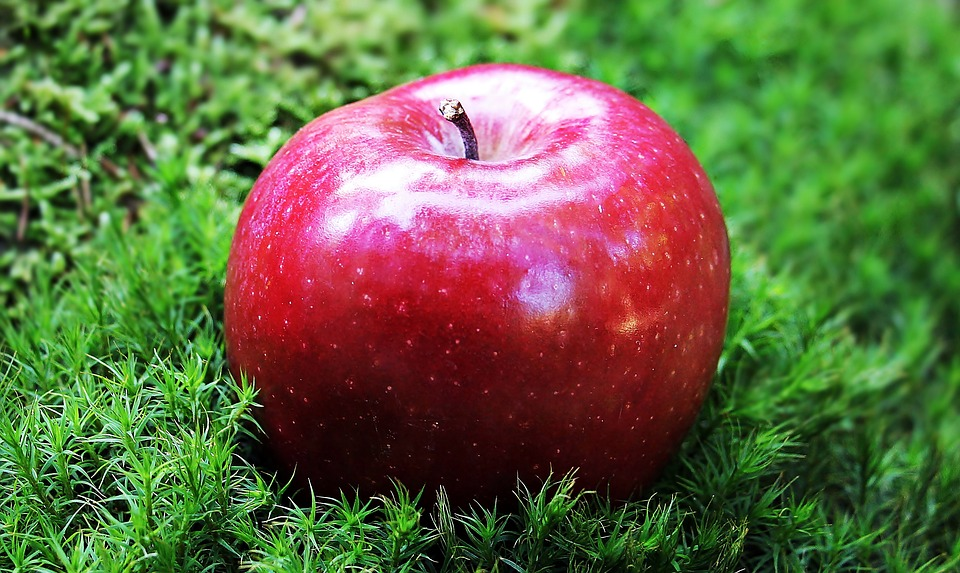

In [49]:
# Supply a path to download a relevant image
IMAGE_PATH = "https://i.ibb.co/2tsXmCV/image.png" 

!wget -q -O image.png $IMAGE_PATH
!cp image.png /content
Image.open('image.png')

In [50]:
# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path="/content/salads_detector_dr.tflite")
interpreter.allocate_tensors()
_, HEIGHT, WIDTH, _ = interpreter.get_input_details()[0]['shape']
print(f"Height and width accepted by the model: {HEIGHT, WIDTH}")

Height and width accepted by the model: (300, 300)


In [51]:
# Image preprocessing utils
def preprocess_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.io.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    original_image = img
    resized_img = tf.image.resize(img, (HEIGHT, WIDTH))
    resized_img = resized_img[tf.newaxis, :]
    return resized_img, original_image

In [52]:
# Define the label dictionary and color map
LABEL_DICT = {
    'Baked Goods' : 1,
    'Cheese' : 2,
    'Salad' : 3,
    'Seafood' : 4,
    'Tomato' : 5
}

REVERSE_LABEL_DICT = {
    1 : "Baked Goods",
    2 : "Cheese",
    3 : "Salad",
    4 : "Seafood",
    5 : "Tomato"
}

COLORS = np.random.randint(0, 255, size=(len(LABEL_DICT), 3), 
                            dtype="uint8")

In [53]:
# Inference utils
def display_results(image_path, threshold=0.3):
    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(image_path)

    # =============Perform inference=====================
    start_time = time.monotonic()
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    print(f"Elapsed time: {(time.monotonic() - start_time)*1000} miliseconds")

    # =============Display the results====================
    original_numpy = original_image.numpy()
    for obj in results:
        # Convert the bounding box figures from relative coordinates
        # to absolute coordinates based on the original resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_numpy.shape[1])
        xmax = int(xmax * original_numpy.shape[1])
        ymin = int(ymin * original_numpy.shape[0])
        ymax = int(ymax * original_numpy.shape[0])

        # Grab the class index for the current iteration
        idx = int(obj['class_id'])
        # Skip the background
        if idx >= len(LABEL_DICT):
            continue

        # Draw the bounding box and label on the image
        color = [int(c) for c in COLORS[idx]]
        cv2.rectangle(original_numpy, (xmin, ymin), (xmax, ymax), 
                    color, 2)
        y = ymin - 15 if ymin - 15 > 15 else ymin + 15
        # label = "{}: {:.2f}%".format(REVERSE_LABEL_DICT[idx], obj['score'] * 100) TODO: FIX THIS
        label= ""
        cv2.putText(original_numpy, label, (xmin, y),
            cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # return the final imaage
    original_int = (original_numpy * 255).astype(np.uint8)
    return original_int

result:  {'bounding_box': array([0.11700168, 0.22978058, 0.88341963, 0.7686416 ], dtype=float32), 'class_id': 52.0, 'score': 0.77498615}
Elapsed time: 95.34134299997277 miliseconds


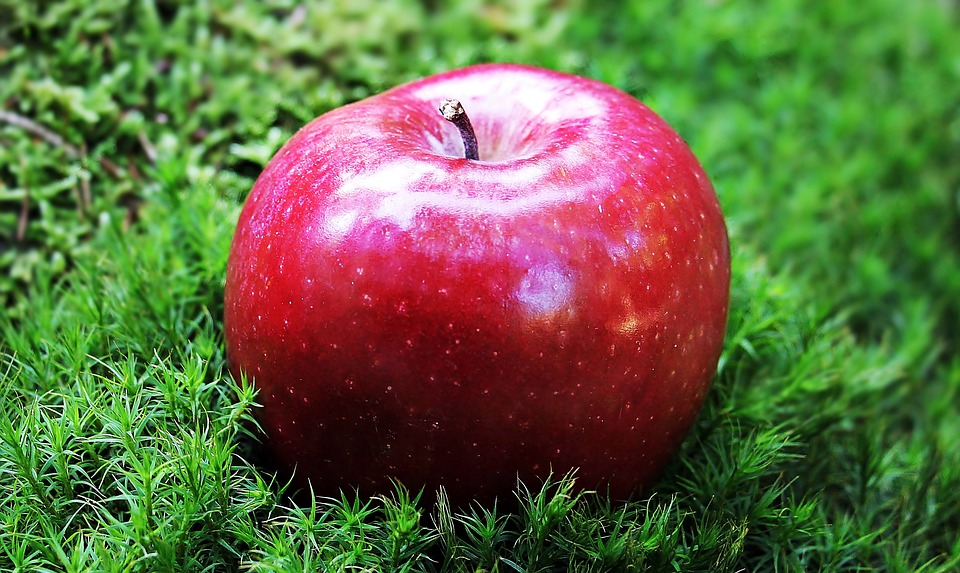

In [54]:
# Run inference and measure the inference time
resultant_image = display_results("/content/image.png", threshold=0.3)
Image.fromarray(resultant_image)

In [55]:
# Define the label dictionary and color map


COLORS = np.random.randint(0, 255, size=(len(LABEL_DICT), 3), 
                            dtype="uint8")

In [57]:

# Inference utils
def display_results(image_path, threshold=0.3):
    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(image_path)

    # =============Perform inference=====================
    start_time = time.monotonic()
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    print(f"Elapsed time: {(time.monotonic() - start_time)*1000} miliseconds")

    # =============Display the results====================
    original_numpy = original_image.numpy()
    for obj in results:
        # Convert the bounding box figures from relative coordinates
        # to absolute coordinates based on the original resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_numpy.shape[1])
        xmax = int(xmax * original_numpy.shape[1])
        ymin = int(ymin * original_numpy.shape[0])
        ymax = int(ymax * original_numpy.shape[0])

        print('box: ', xmin, ymin, ' - ', xmax, ymax)

        # Grab the class index for the current iteration
        idx = int(obj['class_id'])
        # Skip the background
        if idx >= len(LABEL_DICT):
          print('idx >= len(LABEL_DICT)')
          pass
          # continue

        # Draw the bounding box and label on the image
        #color = [int(c) for c in COLORS[idx]]
        color = [int(c) for c in COLORS[0]]
        cv2.rectangle(original_numpy, (xmin, ymin), (xmax, ymax), 
                    color, 2)
        y = ymin - 15 if ymin - 15 > 15 else ymin + 15
        reverse_label = REVERSE_LABEL_DICT[idx] if idx in REVERSE_LABEL_DICT else 'Other'
        label = "{}: {:.2f}%".format(reverse_label, obj['score'] * 100) #TODO: Fix THis
        #label= ""
        cv2.putText(original_numpy, label, (xmin, y),
            cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # return the final imaage
    original_int = (original_numpy * 255).astype(np.uint8)
    return original_int

result:  {'bounding_box': array([0.11700168, 0.22978058, 0.88341963, 0.7686416 ], dtype=float32), 'class_id': 52.0, 'score': 0.77498615}
Elapsed time: 52.41373400008342 miliseconds
box:  220 67  -  737 506
idx >= len(LABEL_DICT)


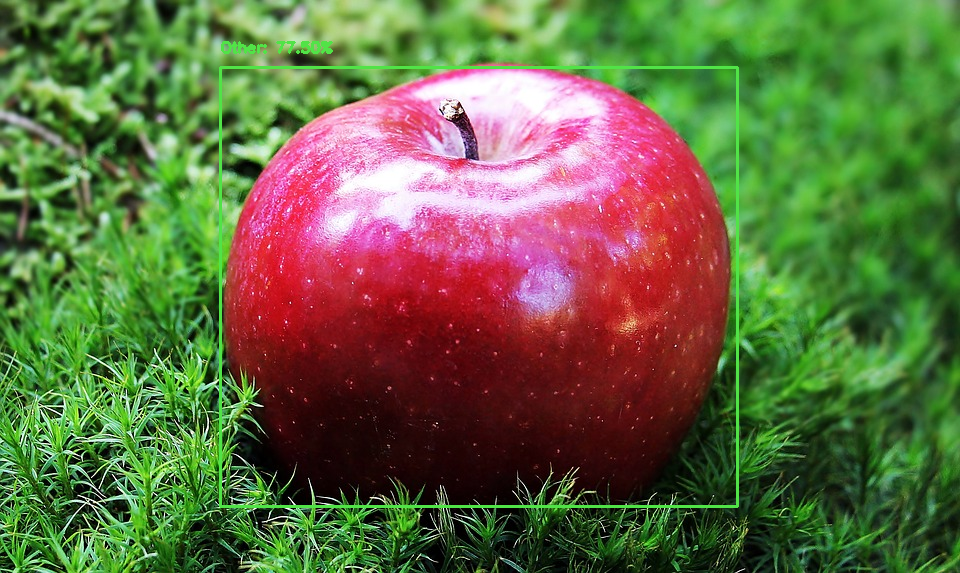

In [58]:
# Run inference and measure the inference time
resultant_image = display_results("/content/image.png", threshold=0.3)
Image.fromarray(resultant_image)

**Note** that you might see some unexpected results because the annotations in the training dataset are faulty at places. Due to this the model training can suffer a lot. 